In [62]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from scipy.integrate import solve_ivp

In [63]:
def lorenz(t, state, sigma=10, rho=28, beta=8/3):
    x, y, z = state
    dxdt = sigma*(y-x)
    dydt = x*(rho-z)-y
    dzdt = x*y - beta*z
    return [dxdt, dydt, dzdt]

In [64]:
t_span = (0, 40)
t_eval = np.linspace(*t_span, 5000)
initial_state = [5.0, 1.0, 1.0]

In [65]:
sol = solve_ivp(lorenz, t_span, initial_state, t_eval=t_eval, method='RK45')
x, y, z = sol.y

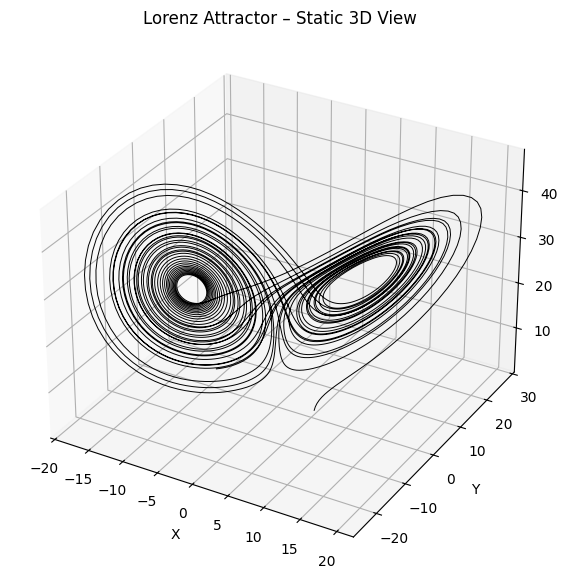

In [66]:
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(projection='3d')
ax.plot(x, y, z, lw=0.7, color='black')
ax.set_title('Lorenz Attractor – Static 3D View')
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
plt.show()

In [67]:
initial_condition = [
    [5., 5., 5.],
    [5.1, 5.1, 5.2],
    [4.8, 5., 4.8]
]
t_span = (0, 40)
t_eval = np.linspace(*t_span, 3000)
def integrate_lorenz(initial_state, t_span, t_eval):
    sol = solve_ivp(lorenz, t_span, initial_state, t_eval=t_eval, method='RK45')
    return sol.y
trajectories = [integrate_lorenz(init, t_span, t_eval) for init in initial_condition]

Animation size has reached 21007792 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


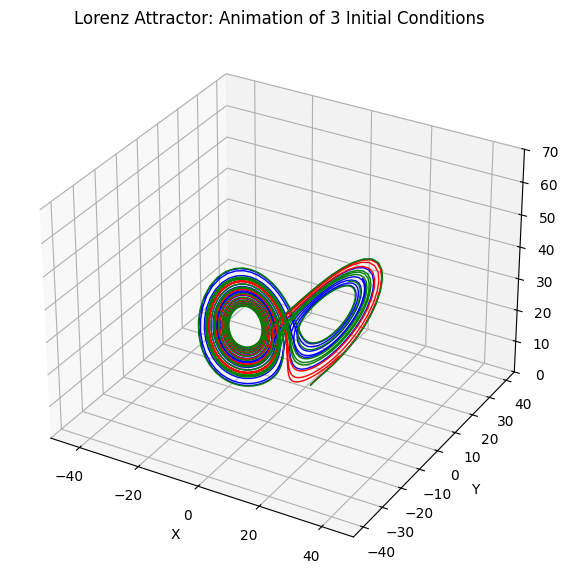

In [ ]:
plt.rcParams['animation.embed_limit'] = 1000  # in MB
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(projection='3d')
ax.set_xlim([-50, 50])
ax.set_ylim([-45, 45])
ax.set_zlim([0, 70])
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Lorenz Attractor: Animation of 3 Initial Conditions')

colors = ['blue', 'red', 'green']
lines = [ax.plot([], [], [], lw=1, color=colors[i], markersize=0.5)[0] for i in range(3)]

def update(num):
    for i in range(3):
        lines[i].set_data(trajectories[i][0][:num], trajectories[i][1][:num])
        lines[i].set_3d_properties(trajectories[i][2][:num])
    return lines

anim = FuncAnimation(fig, update, frames=1000, interval=30, blit=True)

HTML(anim.to_jshtml())